#Final Project: HummingFace

Léo Dupire & Mateus Aragão

##Dataset: NSynth

###Data Characteristics

https://magenta.tensorflow.org/datasets/nsynth#note-qualities

####Dataset Features

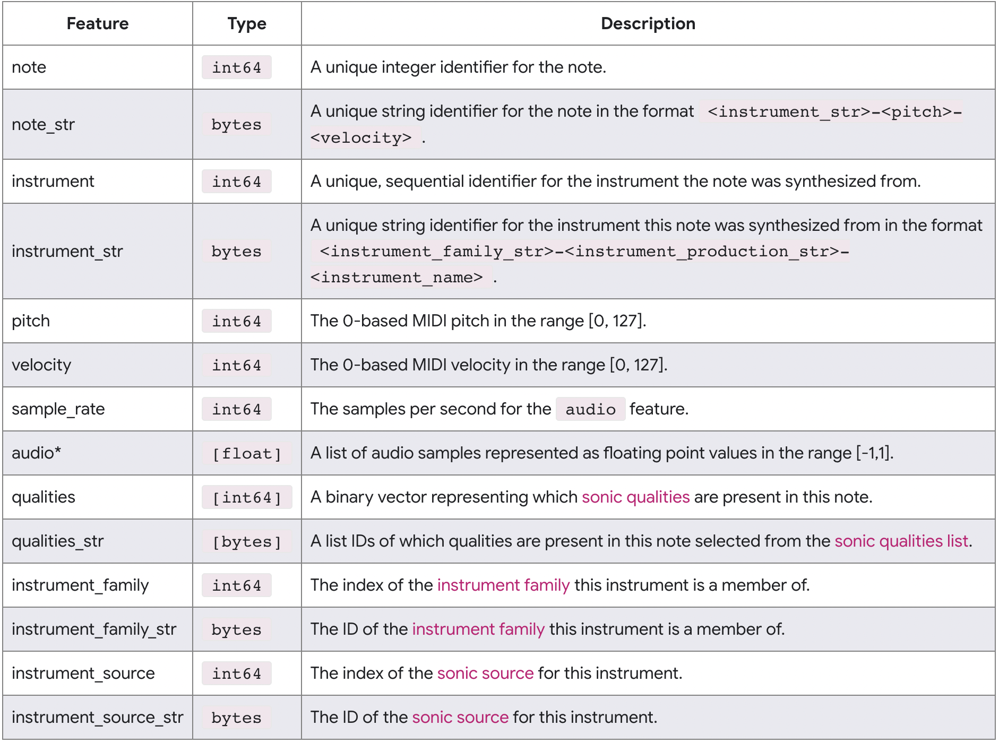

####Qualities Feature Descriptions

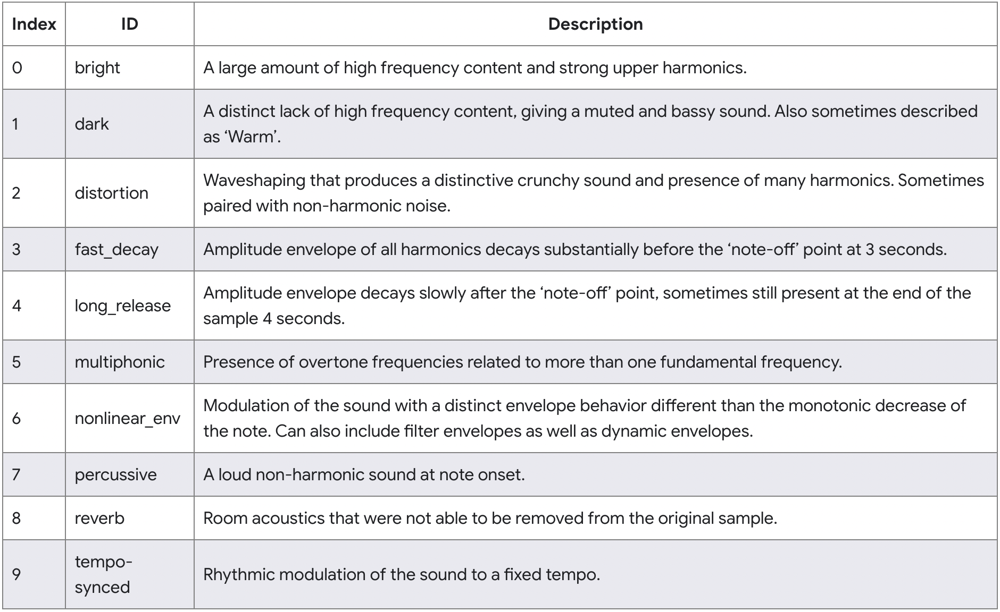

##Import Data

In [ ]:
%cd ./Desktop/HummingFace

/Users/leodupire/Desktop/HummingFace


In [ ]:
# # Import TEST data - must change this to TRAIN in future (for size reasons changed now)
# !wget http://download.magenta.tensorflow.org/datasets/nsynth/nsynth-test.jsonwav.tar.gz
# !tar -xzvf "./nsynth-test.jsonwav.tar.gz"

In [ ]:
SET = "test"

In [ ]:
import pandas as pd

df = pd.read_json(f"./nsynth-{SET}/examples.json", orient='index')
df.head(5)

,qualities,pitch,note,instrument_source_str,velocity,instrument_str,instrument,sample_rate,qualities_str,instrument_source,note_str,instrument_family,instrument_family_str
bass_synthetic_068-049-025,"[0, 1, 0, 0, 0, 0, 0, 0, 0, 0]",49,217499,synthetic,25,bass_synthetic_068,656,16000,[dark],2,bass_synthetic_068-049-025,0,bass
keyboard_electronic_001-021-127,"[0, 0, 0, 0, 0, 0, 0, 0, 0, 0]",21,299359,electronic,127,keyboard_electronic_001,40,16000,[],1,keyboard_electronic_001-021-127,4,keyboard
guitar_acoustic_010-066-100,"[0, 0, 0, 0, 0, 0, 0, 0, 0, 0]",66,72288,acoustic,100,guitar_acoustic_010,219,16000,[],0,guitar_acoustic_010-066-100,3,guitar
reed_acoustic_037-068-127,"[0, 0, 0, 0, 0, 0, 0, 0, 1, 0]",68,22259,acoustic,127,reed_acoustic_037,387,16000,[reverb],0,reed_acoustic_037-068-127,7,reed
flute_acoustic_002-077-100,"[0, 0, 0, 0, 0, 0, 0, 0, 1, 0]",77,72001,acoustic,100,flute_acoustic_002,86,16000,[reverb],0,flute_acoustic_002-077-100,2,flute


##Pre-process Data

In [ ]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt

from scipy import signal
from scipy.io import wavfile
from pydub import AudioSegment
from IPython.display import Audio, display

/Users/leodupire/miniforge3/lib/python3.10/site-packages/pydub/utils.py:170: RuntimeWarning: Couldn't find ffmpeg or avconv - defaulting to ffmpeg, but may not work
  warn("Couldn't find ffmpeg or avconv - defaulting to ffmpeg, but may not work", RuntimeWarning)


The only sample_rate is 16000. We can record this number below and drop this column.

In [ ]:
sample_rate = 16000

data = df.drop(columns=["note", "instrument_str", "instrument", "note_str", "sample_rate", "instrument_family_str"])
data.head()

,qualities,pitch,instrument_source_str,velocity,qualities_str,instrument_source,instrument_family
bass_synthetic_068-049-025,"[0, 1, 0, 0, 0, 0, 0, 0, 0, 0]",49,synthetic,25,[dark],2,0
keyboard_electronic_001-021-127,"[0, 0, 0, 0, 0, 0, 0, 0, 0, 0]",21,electronic,127,[],1,4
guitar_acoustic_010-066-100,"[0, 0, 0, 0, 0, 0, 0, 0, 0, 0]",66,acoustic,100,[],0,3
reed_acoustic_037-068-127,"[0, 0, 0, 0, 0, 0, 0, 0, 1, 0]",68,acoustic,127,[reverb],0,7
flute_acoustic_002-077-100,"[0, 0, 0, 0, 0, 0, 0, 0, 1, 0]",77,acoustic,100,[reverb],0,2


Assign individual column to each of the quality features.

In [ ]:
qualities_data = pd.DataFrame(data.qualities.tolist(), index=data.index, columns=['bright','dark','distortion','fast_decay','long_release','multiphonic','nonlinear_env','percussive','reverb','tempo-synced'])
X = pd.concat([data, qualities_data], axis=1).drop(columns=["instrument_source_str", "qualities", "qualities_str"])
X

,pitch,velocity,instrument_source,instrument_family,bright,dark,distortion,fast_decay,long_release,multiphonic,nonlinear_env,percussive,reverb,tempo-synced
bass_synthetic_068-049-025,49,25,2,0,0,1,0,0,0,0,0,0,0,0
keyboard_electronic_001-021-127,21,127,1,4,0,0,0,0,0,0,0,0,0,0
guitar_acoustic_010-066-100,66,100,0,3,0,0,0,0,0,0,0,0,0,0
reed_acoustic_037-068-127,68,127,0,7,0,0,0,0,0,0,0,0,1,0
flute_acoustic_002-077-100,77,100,0,2,0,0,0,0,0,0,0,0,1,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
brass_acoustic_006-088-075,88,75,0,1,0,0,0,0,0,0,0,0,1,0
organ_electronic_028-044-100,44,100,1,6,0,1,0,0,0,0,0,0,0,0
string_acoustic_071-027-127,27,127,0,8,0,0,0,0,1,0,0,0,1,0
string_acoustic_057-063-127,63,127,0,8,1,0,0,0,0,0,1,0,1,0


###Spectrogram Functions

In [ ]:
# instance: record name
# phase: train, val, or test
def spectrogramify(instance, phase, nperseg=1000):
  dir = "./nsynth-" + str(phase) + "/audio/" + str(instance) + ".wav"
  sample_rate, samples = wavfile.read(dir)
  frequencies, times, spectrogram = signal.stft(samples, fs=sample_rate, nperseg=nperseg)

  return sample_rate, frequencies, times, spectrogram

def show_spectro(times, frequencies, spectrogram):
  f = plt.figure()
  f.set_figwidth(5)
  f.set_figheight(3)

  plt.pcolormesh(times, frequencies, np.abs(spectrogram))
  plt.ylabel('Frequency [Hz]')
  plt.xlabel('Time [sec]')
  plt.ylim([0, 2000])
  plt.show()

def spectro_to_wav(spectrogram, sample_rate = 16000):
  _, gen = signal.istft(spectrogram, sample_rate)
  wavfile.write("output.wav", sample_rate, gen.astype(np.int16))
  return True

def spectro_to_audio(spectrogram, sample_rate = 16000):
  spectro_to_wav(spectrogram, sample_rate)
  wav = "output.wav"
  display(Audio(wav, autoplay=True))

def decompose_spect(y):
  y_real = []
  y_imag = []
  for i in range(len(y)):
    y_real.append(y[i].real)
    y_imag.append(y[i].imag)
  return np.array(y_real), np.array(y_imag)

def recompose_spect(y_real, y_imag):
  y = 1j*y_imag
  y += y_real
  return np.array(y)

###Data Manipulations

In [ ]:
X = X.loc[(X.percussive != 1) & (X.pitch == 60)].drop(columns=["percussive"])
X

,pitch,velocity,instrument_source,instrument_family,bright,dark,distortion,fast_decay,long_release,multiphonic,nonlinear_env,reverb,tempo-synced
organ_electronic_001-060-127,60,127,1,6,0,1,0,0,0,0,0,0,0
keyboard_electronic_002-060-050,60,50,1,4,0,0,0,0,0,0,0,0,0
guitar_acoustic_014-060-127,60,127,0,3,0,0,0,0,0,0,0,0,0
reed_acoustic_037-060-100,60,100,0,7,0,0,0,0,1,0,0,1,0
organ_electronic_028-060-075,60,75,1,6,0,1,0,0,0,0,0,0,0
organ_electronic_001-060-100,60,100,1,6,0,1,0,0,0,0,0,0,0
vocal_acoustic_000-060-075,60,75,0,10,0,0,0,0,0,0,0,1,0
bass_synthetic_098-060-127,60,127,2,0,0,0,1,0,0,0,0,0,0
brass_acoustic_015-060-127,60,127,0,1,0,0,0,0,0,0,0,1,0
bass_synthetic_068-060-050,60,50,2,0,0,1,0,0,0,0,0,0,0


###Convert to square matrix: 129x129

Sounds essentially stays the same:

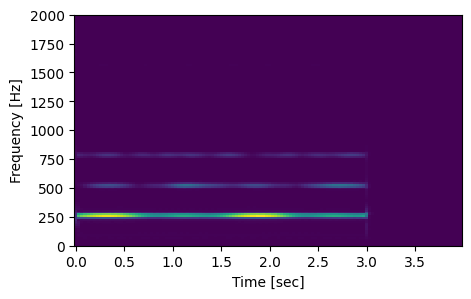

In [ ]:
# _, frequencies, times, spectrogram = spectrogramify(X.index[0], "test")
show_spectro(times[:128], frequencies[:128], spectrogram[:128, :128])
spectro_to_audio(spectrogram, sample_rate)

Convert the .wav files to spectrograms:

In [ ]:
dataset = {"instance": [], "spectrogram": [], "freq": [], "times": []}
for instance in X.index:
  _, frequencies, times, spectrogram = spectrogramify(instance, SET)
  dataset["instance"].append(instance)
  dataset["spectrogram"].append(spectrogram[:128, :128])
  dataset["freq"].append(frequencies[:128])
  dataset["times"].append(times[:128])

####Display some spectrograms:

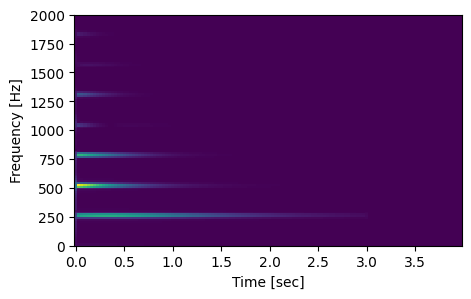

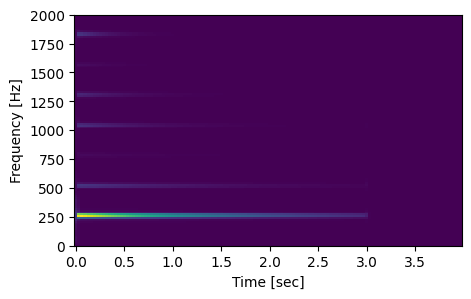

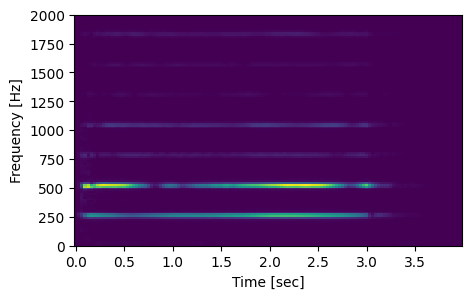

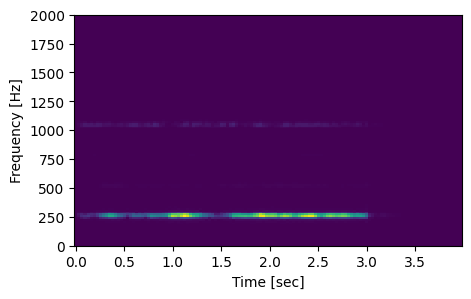

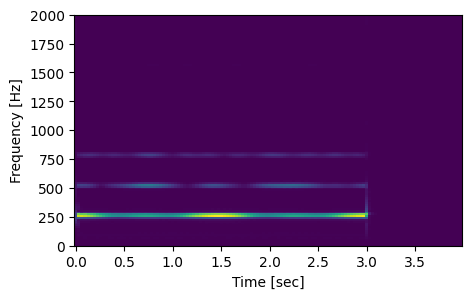

In [ ]:
for row in [1,2,3,4,5]:
  show_spectro(dataset["times"][row], dataset["freq"][row], dataset["spectrogram"][row])

####Play sound clip

In [ ]:
spectro_to_audio(dataset["spectrogram"][10])

####Save and Load Data

Convert imaginary number to 2 arrays of real numbers (one corresponding to imaginary coefficient).

In [ ]:
dataset_real, dataset_imag = decompose_spect(dataset["spectrogram"])

In [ ]:
np.save(f"./{SET}_real.npy", dataset_real)
np.save(f"./{SET}_imag.npy", dataset_imag)
X.to_csv(f"./{SET}_df.csv")

Load:

In [ ]:
train_real = np.load("./train_real.npy")
train_imag = np.load("./train_imag.npy")
X = pd.read_csv("./train_df.csv")

test_real = np.load("./test_real.npy")
test_imag = np.load("./test_imag.npy")
test_X = pd.read_csv("./test_df.csv")

#Models

##GAN (Conditional GAN showed _separately_ in another file! Including this to show our workflow, feel free to disregard the one below) 

This GAN did not perform well. It outputs noise, much like the Conditional GAN.

https://machinelearningmastery.com/upsampling-and-transpose-convolution-layers-for-generative-adversarial-networks/

In [ ]:
import tensorflow as tf
# from tensorflow.keras import datasets, layers, models
from keras.models import Sequential
from keras.layers import Dense, Reshape, UpSampling2D, Conv2D, Conv2DTranspose, LeakyReLU, Flatten, Dropout
from keras import Input, Model, metrics, optimizers
from keras.utils.vis_utils import plot_model
from keras.optimizers import Adam

###Custom Loss Function: Distance between matrices

In [ ]:
from sklearn.metrics import pairwise_distances

def dissimilarity_loss(y_true, y_pred, metric="euclidean"):
  losses = []
  for i in range(len(y_pred)):
    losses.append(pairwise_distances(y_true[i], y_pred[i], metric=metric))
  return np.array(losses)

###Build & Compile Model

####Discriminator

https://machinelearningmastery.com/how-to-develop-a-generative-adversarial-network-for-an-mnist-handwritten-digits-from-scratch-in-keras/

In [ ]:
# define the standalone discriminator model
def define_discriminator(in_shape=(501,129,2)):
	model = Sequential()
	model.add(Conv2D(64, (3,3), strides=(2, 2), padding='same', input_shape=in_shape))
	model.add(LeakyReLU(alpha=0.2))
	model.add(Dropout(0.4))
	model.add(Conv2D(64, (3,3), strides=(2, 2), padding='same'))
	model.add(LeakyReLU(alpha=0.2))
	model.add(Dropout(0.4))
	model.add(Flatten())
	model.add(Dense(1, activation='sigmoid'))
	# compile model
	opt = Adam(lr=0.0002, beta_1=0.5)
	model.compile(loss='binary_crossentropy', optimizer=opt, metrics=['accuracy'])
	return model
 
# define model
model = define_discriminator()
# summarize the model
model.summary()
# plot the model
plot_model(model, to_file='discriminator_plot.png', show_shapes=True, show_layer_names=True)

In [ ]:
# select real samples
def generate_real_samples(dataset, n_samples):
  # choose random instances
  ix = np.random.randint(0, dataset.shape[0], n_samples)
  # retrieve selected images
  X = dataset[ix]
  # generate 'real' class labels (1)
  y = np.ones((n_samples, 1))
  return X, y

In [ ]:
# use the generator to generate n fake examples, with class labels
def generate_fake_samples(g_model, latent_dim, n_samples):
	# generate points in latent space
	x_input = generate_latent_points(latent_dim, n_samples)
	# predict outputs
	X = g_model.predict(x_input)
	# create 'fake' class labels (0)
	y = np.zeros((n_samples, 1))
	return X, y

#####Train Discriminator

In [ ]:
# train the discriminator model
def train_discriminator(model, dataset, n_iter=100, n_batch=256):
	half_batch = int(n_batch / 2)
	# manually enumerate epochs
	for i in range(n_iter):
		# get randomly selected 'real' samples
		X_real, y_real = generate_real_samples(dataset, half_batch)
		# update discriminator on real samples
		_, real_acc = model.train_on_batch(X_real, y_real)
		# generate 'fake' examples
		X_fake, y_fake = generate_fake_samples(half_batch)
		# update discriminator on fake samples
		_, fake_acc = model.train_on_batch(X_fake, y_fake)
		# summarize performance
		print('>%d real=%.0f%% fake=%.0f%%' % (i+1, real_acc*100, fake_acc*100))

####Generator

"LeakyReLU with a default slope of 0.2, reported as a best practice when training GAN models."

In [ ]:
# define the standalone generator model
def define_generator(latent_dim):
  model = Sequential()
  # foundation for 7x7 image
  n_nodes = 64 * 5 * 5
  model.add(Dense(n_nodes, input_dim=15))
  model.add(LeakyReLU(alpha=0.2))
  model.add(Reshape((5, 5, 64)))
  # Upsample
  model.add(UpSampling2D())
  model.add(Conv2D(64, (3,3), padding='same'))
  model.add(LeakyReLU(alpha=0.2))
  # Upsample
  model.add(Conv2DTranspose(64, (3,3), strides=(2,2), padding='same'))
  model.add(LeakyReLU(alpha=0.2))
  model.add(UpSampling2D())
  # Upsample
  model.add(Conv2DTranspose(64, (8,8), strides=(3,3)))
  model.add(LeakyReLU(alpha=0.2))
  model.add(Conv2DTranspose(2, (5,5), strides=(4,1)))

  return model

####Latent Space Operations

In [ ]:
# define the size of the latent space
latent_dim = 15
# define the generator model
model = define_generator(latent_dim)
# summarize the model
model.summary()
# plot the model
plot_model(model, to_file='generator_plot.png', show_shapes=True, show_layer_names=True)

In [ ]:
# generate points in latent space as input for the generator
def generate_latent_points(latent_dim, n_samples):
	# generate points in the latent space
	x_input = np.random.randn(latent_dim * n_samples)
	# reshape into a batch of inputs for the network
	x_input = x_input.reshape(n_samples, latent_dim)
	return x_input

In [ ]:
# size of the latent space
latent_dim = 15
# define the discriminator model
model = define_generator(latent_dim)
# generate samples
n_samples = 5
X, _ = generate_fake_samples(model, latent_dim, n_samples)

In [ ]:
X_gen = recompose_spect(X[:, :, :, 0], X[:, :, :, 1]) # Turn into complex valued array

In [ ]:
# plot the generated samples
for i in range(n_samples):
  show_spectro(y['times'][0], y['freq'][0], X_gen[i])

No audible sound as all the values are too low.

In [ ]:
spectro_to_audio(X_gen[0])

###GAN

In [ ]:
# define the combined generator and discriminator model, for updating the generator
def define_gan(g_model, d_model):
  # make weights in the discriminator not trainable
  d_model.trainable = False
  # connect them
  model = Sequential()
  # add generator
  model.add(g_model)
  # add the discriminator
  model.add(d_model)
  # compile model
  opt = Adam(lr=0.0002, beta_1=0.5)
  model.compile(loss='binary_crossentropy', optimizer=opt)
  return model

In [ ]:
# size of the latent space
latent_dim = 15
# create the discriminator
d_model = define_discriminator()
# create the generator
g_model = define_generator(latent_dim)
# create the gan
gan_model = define_gan(g_model, d_model)
# summarize gan model
gan_model.summary()
# plot gan model
plot_model(gan_model, to_file='gan_plot.png', show_shapes=True, show_layer_names=True)

####Train GAN

In [ ]:
# train the composite model
def train_gan(gan_model, latent_dim, n_epochs=100, n_batch=256):
	# manually enumerate epochs
	for i in range(n_epochs):
		# prepare points in latent space as input for the generator
		x_gan = generate_latent_points(latent_dim, n_batch)
		# create inverted labels for the fake samples
		y_gan = np.ones((n_batch, 1))
		# update the generator via the discriminator's error
		gan_model.train_on_batch(x_gan, y_gan)

In [ ]:
# train the generator and discriminator
def train(g_model, d_model, gan_model, dataset, latent_dim, n_epochs=50, n_batch=256):
  bat_per_epo = int(dataset.shape[0] / n_batch)
  half_batch = int(n_batch / 2)
  # manually enumerate epochs
  for i in range(n_epochs):
    # enumerate batches over the training set
    for j in range(bat_per_epo):
      # get randomly selected 'real' samples
      X_real, y_real = generate_real_samples(dataset, half_batch)
      # generate 'fake' examples
      X_fake, y_fake = generate_fake_samples(g_model, latent_dim, half_batch)
      # create training set for the discriminator
      X = np.vstack((X_real.reshape(128, 501, 129, 1), X_fake)) # Reshape because of dimension bug
      y = np.vstack((y_real, y_fake))
      # update discriminator model weights
      d_loss, _ = d_model.train_on_batch(X, y)
      # prepare points in latent space as input for the generator
      X_gan = generate_latent_points(latent_dim, n_batch)
      # create inverted labels for the fake samples
      y_gan = np.ones((n_batch, 1))
      # update the generator via the discriminator's error
      g_loss = gan_model.train_on_batch(X_gan, y_gan)
      # summarize loss on this batch
      print('>%d, %d/%d, d=%.3f, g=%.3f' % (i+1, j+1, bat_per_epo, d_loss, g_loss))

    # evaluate the model performance, sometimes
    if (i+1) % 10 == 0:
      summarize_performance(i, g_model, d_model, dataset, latent_dim)

####Evaluation

In [ ]:
# evaluate the discriminator, plot generated images, save generator model
def summarize_performance(epoch, g_model, d_model, dataset, latent_dim, n_samples=100):
  # prepare real samples
  X_real, y_real = generate_real_samples(dataset, n_samples)
  # evaluate discriminator on real examples
  _, acc_real = d_model.evaluate(X_real, y_real, verbose=0)
  # prepare fake examples
  x_fake, y_fake = generate_fake_samples(g_model, latent_dim, n_samples)
  # evaluate discriminator on fake examples
  _, acc_fake = d_model.evaluate(x_fake, y_fake, verbose=0)
  # summarize discriminator performance
  print('>Accuracy real: %.0f%%, fake: %.0f%%' % (acc_real*100, acc_fake*100))
  # save plot
  save_plot(x_fake, epoch)
  # save the generator model tile file
  filename = 'generator_model_%03d.h5' % (epoch + 1)
  g_model.save(filename)

In [ ]:
# create and save a plot of generated images (reversed grayscale)
def save_plot(examples, epoch, n=10):
  # plot images
  for i in range(n * n):
    show_spectro(y['times'][0], y['freq'][0], examples[i, :, :, 0])

In [ ]:
# size of the latent space
latent_dim = 15
# create the discriminator
d_model = define_discriminator()
# create the generator
g_model = define_generator(latent_dim)
# create the gan
gan_model = define_gan(g_model, d_model)
# load image data
dataset = np.array([y_real, y_imag]).reshape(1000, 501, 129, 2)

In [ ]:
# train model
train(g_model, d_model, gan_model, dataset, latent_dim)

####GAN Output

In [ ]:
from keras.models import load_model
from numpy.random import randn
from matplotlib import pyplot
import numpy as np

In [ ]:
# load model
model = load_model('generator_model_0_020.h5')
# generate images
latent_points = generate_latent_points(15, 10)
# generate images
preds = model.predict(latent_points)

In [ ]:
X_gen = recompose_spect(preds[:, :, :, 0], preds[:, :, :, 1]) # Turn into complex valued array

# plot the generated samples
for i in range(X_gen.shape[0]):
  show_spectro(y['times'][0], y['freq'][0], X_gen[i])

In [ ]:
spectro_to_audio(X_gen[0])

##Autoencoder (This was used)

In [ ]:
# Importing the necessary libraries
import numpy as np
import matplotlib.pyplot as plt
import torchvision
import torch
import torch.nn as nn
from torch.utils.data import Dataset

In [ ]:
train_real = torch.tensor(train_real).reshape([train_real.shape[0], 1, train_real.shape[1], train_real.shape[2]])
train_imag = torch.tensor(train_imag).reshape([train_imag.shape[0], 1, train_imag.shape[1], train_imag.shape[2]])

test_real = torch.tensor(test_real).reshape([test_real.shape[0], 1, test_real.shape[1], test_real.shape[2]])
test_imag = torch.tensor(test_imag).reshape([test_imag.shape[0], 1, test_imag.shape[1], test_imag.shape[2]])

In [ ]:
train_set = torch.cat((train_real, train_imag), 1)
val_set = train_set[:round(train_set.shape[0]*0.2)] # Get val from train data: 20% of the data
train_set = train_set[val_set.shape[0]:] # Adjust the training set accordingly
test_set = torch.cat((test_real, test_imag), 1)
train_set.shape

torch.Size([3070, 2, 128, 128])

In [ ]:
class SpectrogramDataset(Dataset):
  def __init__(self, data, transform=None):
    self.annotations = data
    self.transform = transform
  
  def __len__(self):
    return len(self.annotations)
  
  def __getitem__(self, index):
    image = self.annotations[index]
    y = None

    if self.transform:
      image = self.transform(image)

    return (image, y)

train_dataset = SpectrogramDataset(train_set)
val_dataset = SpectrogramDataset(train_set)
test_dataset = SpectrogramDataset(test_set)

train_loader = torch.utils.data.DataLoader(
    train_set, batch_size=256)

val_loader = torch.utils.data.DataLoader(
    val_set, batch_size=256)

test_loader = torch.utils.data.DataLoader(
    test_set, batch_size=256)

In [ ]:
train_dataset.__len__()

3070

In [ ]:
#@title Imports
## Standard libraries
import os
import json
import math
import numpy as np
import math

## Imports for plotting
import matplotlib.pyplot as plt
%matplotlib inline
from IPython.display import set_matplotlib_formats
set_matplotlib_formats('svg', 'pdf') # For export
from matplotlib.colors import to_rgb
import matplotlib
matplotlib.rcParams['lines.linewidth'] = 2.0
import seaborn as sns
sns.reset_orig()
sns.set()

## Progress bar
from tqdm.notebook import tqdm

## PyTorch
import torch
import torch.nn as nn
import torch.nn.functional as F
import torch.utils.data as data
import torch.optim as optim
# Torchvision
import torchvision
from torchvision.datasets import CIFAR10
from torchvision import transforms
# PyTorch Lightning
try:
    import pytorch_lightning as pl
except ModuleNotFoundError: # Google Colab does not have PyTorch Lightning installed by default. Hence, we do it here if necessary
    !pip install --quiet pytorch-lightning>=1.4
    import pytorch_lightning as pl
from pytorch_lightning.callbacks import LearningRateMonitor, ModelCheckpoint

# Tensorboard extension (for visualization purposes later)
from torch.utils.tensorboard import SummaryWriter
%load_ext tensorboard

The tensorboard extension is already loaded. To reload it, use:
  %reload_ext tensorboard


/var/folders/01/4rw9wbtn40s22slt7887wq7r0000gn/T/ipykernel_58019/1642405584.py:13: DeprecationWarning: `set_matplotlib_formats` is deprecated since IPython 7.23, directly use `matplotlib_inline.backend_inline.set_matplotlib_formats()`
  set_matplotlib_formats('svg', 'pdf') # For export


In [186]:
var = 16 # This variable determines fully connected layer input size

In [201]:
#@title Encoder
class Encoder(nn.Module):

    def __init__(self,
                 num_input_channels : int,
                 base_channel_size : int,
                 latent_dim : int,
                 act_fn : object = nn.GELU):
        """
        Inputs:
            - num_input_channels : Number of input channels of the image. For CIFAR, this parameter is 3
            - base_channel_size : Number of channels we use in the first convolutional layers. Deeper layers might use a duplicate of it.
            - latent_dim : Dimensionality of latent representation z
            - act_fn : Activation function used throughout the encoder network
        """
        super().__init__()
        c_hid = base_channel_size

        self.conv_layer1 = nn.Conv2d(num_input_channels, c_hid, kernel_size=3, padding=1, stride=2) # 32x32 => 16x16
        self.act1 = act_fn()
        self.conv_layer2 = nn.Conv2d(c_hid, c_hid, kernel_size=3, padding=1)
        self.act2 = act_fn()
        self.conv_layer3 = nn.Conv2d(c_hid, 2*c_hid, kernel_size=3, padding=1, stride=2) # 16x16 => 8x8
        self.act3 = act_fn()
        self.conv_layer4 = nn.Conv2d(2*c_hid, 2*c_hid, kernel_size=3, padding=1)
        self.act4 = act_fn()
        self.conv_layer5 = nn.Conv2d(2*c_hid, 2*c_hid, kernel_size=3, padding=1, stride=2) # 8x8 => 4x4
        self.act5 = act_fn()
        self.net = nn.Sequential(
            nn.Flatten(), # Image grid to single feature vector
            nn.Linear(2*(var*var)*c_hid, latent_dim)
        )

    def j(self):
        spectrogram = recompose_spect(self.a, self.b)
        print(spectrogram)
        show_spectro(dataset["times"], dataset["frequencies"] , spectrogram)
        spectro_to_audio(spectrogram, sample_rate)

    def forward(self, x):
        # print(x.shape)
        self.a = x[0]
        # print(spectrogram)
        # show_spectro(dataset["times"], dataset["frequencies"] , spectrogram)
        # spectro_to_audio(spectrogram, sample_rate)

        out = self.conv_layer1(x)
        out = self.act1(out)
        # print(out.shape)
        out = self.conv_layer2(out)
        out = self.act2(out)
        # print(out.shape)
        out = self.conv_layer3(out)
        out = self.act3(out)
        # print(out.shape)
        out = self.conv_layer4(out)
        out = self.act4(out)
        # print(out.shape)
        out = self.conv_layer5(out)
        out = self.act5(out)
        # print(out.shape)
        out = self.net(out)
        # print(out.shape)

        return out

In [202]:
#@title Decoder
class Decoder(nn.Module):

    def __init__(self,
                 num_input_channels : int,
                 base_channel_size : int,
                 latent_dim : int,
                 act_fn : object = nn.GELU):
        """
        Inputs:
            - num_input_channels : Number of channels of the image to reconstruct. For CIFAR, this parameter is 3
            - base_channel_size : Number of channels we use in the last convolutional layers. Early layers might use a duplicate of it.
            - latent_dim : Dimensionality of latent representation z
            - act_fn : Activation function used throughout the decoder network
        """
        super().__init__()
        c_hid = base_channel_size
        self.linear = nn.Sequential(
            nn.Linear(latent_dim, 2*(var*var)*c_hid), 
            act_fn()
        )
        
        self.convT_layer1 = nn.ConvTranspose2d(2*c_hid, 2*c_hid, kernel_size=3, output_padding=1, padding=1, stride=2) # 4x4 => 8x8
        self.act1 = act_fn()
        self.conv_layer1 = nn.Conv2d(2*c_hid, 2*c_hid, kernel_size=3, padding=1)
        self.act2 = act_fn()
        self.convT_layer2 = nn.ConvTranspose2d(2*c_hid, c_hid, kernel_size=3, output_padding=1, padding=1, stride=2) # 8x8 => 16x16
        self.act3 = act_fn()
        self.conv_layer2 = nn.Conv2d(c_hid, c_hid, kernel_size=3, padding=1)
        self.act4 = act_fn()
        self.convT_layer3 = nn.ConvTranspose2d(c_hid, num_input_channels, kernel_size=3, output_padding=1, padding=1, stride=2) # 16x16 => 32x32
        # self.tanh = nn.Tanh() # The input images is scaled between -1 and 1, hence the output has to be bounded as well
        

    def forward(self, x):
        x = self.linear(x)
        x = x.reshape(x.shape[0], -1, 16, 16)

        out = self.convT_layer1(x)
        out = self.act1(out)
        out = self.conv_layer1(out)
        out = self.act2(out)
        out = self.convT_layer2(out)
        out = self.act3(out)
        out = self.conv_layer2(out)
        out = self.act4(out)
        out = self.convT_layer3(out)

        return out

In [203]:
#@title Autoencoder
class Autoencoder(pl.LightningModule):
    def __init__(self,
                 base_channel_size: int,
                 latent_dim: int,
                 encoder_class : object = Encoder,
                 decoder_class : object = Decoder,
                 num_input_channels: int = 2,
                 width: int = 128,
                 height: int = 128):
        super().__init__()
        # Saving hyperparameters of autoencoder
        self.save_hyperparameters()
        # Creating encoder and decoder
        self.encoder = encoder_class(num_input_channels, base_channel_size, latent_dim)
        self.decoder = decoder_class(num_input_channels, base_channel_size, latent_dim)
        # Example input array needed for visualizing the graph of the network
        self.example_input_array = torch.zeros(1, num_input_channels, width, height)

    def forward(self, x):
        """
        The forward function takes in an image and returns the reconstructed image
        """
        # print("FOR")
        z = self.encoder(x)
        x_hat = self.decoder(z)

        return x_hat

    def _get_reconstruction_loss(self, batch):
        """
        Given a batch of images, this function returns the reconstruction loss (MSE in our case)
        """
        # print("REC")
        x = batch # We do not need the labels
        x_hat = self.forward(x)
        loss = F.mse_loss(x, x_hat, reduction="none")
        loss = loss.sum(dim=[1,2,3]).mean(dim=[0])
        return loss

    def configure_optimizers(self):
        # print("OPT")
        optimizer = optim.Adam(self.parameters(), lr=1e-3)
        # Using a scheduler is optional but can be helpful.
        # The scheduler reduces the LR if the validation performance hasn't improved for the last N epochs
        scheduler = optim.lr_scheduler.ReduceLROnPlateau(optimizer,
                                                         mode='min',
                                                         factor=0.2,
                                                         patience=20,
                                                         min_lr=5e-5)
        return {"optimizer": optimizer, "lr_scheduler": scheduler, "monitor": "val_loss"}

    def training_step(self, batch, batch_idx):
        # print("TRA")
        loss = self._get_reconstruction_loss(batch)
        self.log('train_loss', loss)
        return loss

    def validation_step(self, batch, batch_idx):
        # print("VAL")
        loss = self._get_reconstruction_loss(batch)
        self.log('val_loss', loss)

    def test_step(self, batch, batch_idx):
        # print("TEST")
        loss = self._get_reconstruction_loss(batch)
        self.log('test_loss', loss)

In [204]:
#@title Callback
class GenerateCallback(pl.Callback):
    def __init__(self, input_imgs, every_n_epochs=1):
        super().__init__()
        self.input_imgs = input_imgs # Images to reconstruct during training
        self.every_n_epochs = every_n_epochs # Only save those images every N epochs (otherwise tensorboard gets quite large)

    def on_train_epoch_end(self, trainer, pl_module):
        if trainer.current_epoch % self.every_n_epochs == 0:
            # Reconstruct images
            input_imgs = self.input_imgs.to(pl_module.device)
            with torch.no_grad():
                pl_module.eval()
                reconst_imgs = pl_module(input_imgs)
                pl_module.train()
            # Plot and add to tensorboard
            imgs = torch.stack([input_imgs, reconst_imgs], dim=1).flatten(0,1)
            grid = torchvision.utils.make_grid(imgs, nrow=2, normalize=True, range=(-1,1))
            trainer.logger.experiment.add_image("Reconstructions", grid, global_step=trainer.global_step)

###Train

In [205]:
def train_auto(latent_dim, num_epochs):
    # Create a PyTorch Lightning trainer with the generation callback
    trainer = pl.Trainer(default_root_dir=os.path.join(CHECKPOINT_PATH, f"auto_{latent_dim}"),
                         accelerator="gpu",
                         max_epochs=num_epochs)

    model = Autoencoder(base_channel_size=128, latent_dim=latent_dim)
    trainer.fit(model, train_loader, val_loader)
    
    # Test best model on validation and test set
    val_result = trainer.test(model, val_loader, verbose=False)
    test_result = trainer.test(model, test_loader, verbose=False)
    result = {"test": test_result, "val": val_result}
    return model, result

In [68]:
num_epochs = 30
CHECKPOINT_PATH = "./Callbacks"
model_dict = {}
for latent_dim in [48]:
    model_ld, result_ld = train_auto(latent_dim, num_epochs)
    model_dict[latent_dim] = {"model": model_ld, "result": result_ld}

GPU available: True (mps), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs
Missing logger folder: Callbacks/auto_48/lightning_logs

  | Name    | Type    | Params | In sizes         | Out sizes       
--------------------------------------------------------------------------
0 | encoder | Encoder | 4.8 M  | [1, 2, 128, 128] | [1, 48]         
1 | decoder | Decoder | 4.8 M  | [1, 48]          | [1, 2, 128, 128]
--------------------------------------------------------------------------
9.6 M     Trainable params
0         Non-trainable params
9.6 M     Total params
38.430    Total estimated model params size (MB)


Sanity Checking: 0it [00:00, ?it/s]

/Users/leodupire/miniforge3/lib/python3.10/site-packages/pytorch_lightning/trainer/connectors/data_connector.py:224: PossibleUserWarning: The dataloader, val_dataloader 0, does not have many workers which may be a bottleneck. Consider increasing the value of the `num_workers` argument` (try 10 which is the number of cpus on this machine) in the `DataLoader` init to improve performance.
  rank_zero_warn(


/Users/leodupire/miniforge3/lib/python3.10/site-packages/pytorch_lightning/trainer/connectors/data_connector.py:224: PossibleUserWarning: The dataloader, train_dataloader, does not have many workers which may be a bottleneck. Consider increasing the value of the `num_workers` argument` (try 10 which is the number of cpus on this machine) in the `DataLoader` init to improve performance.
  rank_zero_warn(
/Users/leodupire/miniforge3/lib/python3.10/site-packages/pytorch_lightning/trainer/trainer.py:1595: PossibleUserWarning: The number of training batches (24) is smaller than the logging interval Trainer(log_every_n_steps=50). Set a lower value for log_every_n_steps if you want to see logs for the training epoch.
  rank_zero_warn(


Epoch 0:  80%|████████  | 24/30 [00:37<00:09,  1.55s/it, loss=4.38e+09, v_num=0]
Validation: 0it [00:00, ?it/s]
Epoch 1:  80%|████████  | 24/30 [00:28<00:07,  1.20s/it, loss=3.45e+09, v_num=0]
Validation: 0it [00:00, ?it/s]
Epoch 2:  80%|████████  | 24/30 [00:28<00:07,  1.17s/it, loss=2.58e+09, v_num=0]
Validation: 0it [00:00, ?it/s]
Epoch 3:  80%|████████  | 24/30 [00:40<00:10,  1.69s/it, loss=2.19e+09, v_num=0]
Validation: 0it [00:00, ?it/s]
Epoch 4:  80%|████████  | 24/30 [00:28<00:07,  1.18s/it, loss=2.02e+09, v_num=0]
Validation: 0it [00:00, ?it/s]
Epoch 5:  80%|████████  | 24/30 [00:28<00:07,  1.17s/it, loss=1.92e+09, v_num=0]
Validation: 0it [00:00, ?it/s]
Epoch 6:  80%|████████  | 24/30 [00:27<00:06,  1.16s/it, loss=1.86e+09, v_num=0]
Validation: 0it [00:00, ?it/s]
Epoch 7:  80%|████████  | 24/30 [00:27<00:06,  1.17s/it, loss=1.81e+09, v_num=0]
Validation: 0it [00:00, ?it/s]
Epoch 8:  80%|████████  | 24/30 [00:28<00:07,  1.18s/it, loss=1.78e+09, v_num=0]
Validation: 0it [00:00,

`Trainer.fit` stopped: `max_epochs=30` reached.


Epoch 29: 100%|█████████| 30/30 [00:31<00:00,  1.05s/it, loss=7.31e+08, v_num=0]


/Users/leodupire/miniforge3/lib/python3.10/site-packages/pytorch_lightning/trainer/connectors/data_connector.py:224: PossibleUserWarning: The dataloader, test_dataloader 0, does not have many workers which may be a bottleneck. Consider increasing the value of the `num_workers` argument` (try 10 which is the number of cpus on this machine) in the `DataLoader` init to improve performance.
  rank_zero_warn(


Testing DataLoader 0: 100%|███████████████████████| 1/1 [00:00<00:00,  4.00it/s]


###Model Summary

In [121]:
from torchsummary import summary
summary(model_ld, input_size=(2, 128, 128))

----------------------------------------------------------------
        Layer (type)               Output Shape         Param #
            Conv2d-1          [-1, 128, 64, 64]           2,432
              GELU-2          [-1, 128, 64, 64]               0
            Conv2d-3          [-1, 128, 64, 64]         147,584
              GELU-4          [-1, 128, 64, 64]               0
            Conv2d-5          [-1, 256, 32, 32]         295,168
              GELU-6          [-1, 256, 32, 32]               0
            Conv2d-7          [-1, 256, 32, 32]         590,080
              GELU-8          [-1, 256, 32, 32]               0
            Conv2d-9          [-1, 256, 16, 16]         590,080
             GELU-10          [-1, 256, 16, 16]               0
          Flatten-11                [-1, 65536]               0
           Linear-12                   [-1, 48]       3,145,776
          Encoder-13                   [-1, 48]               0
           Linear-14                [-1

###Results

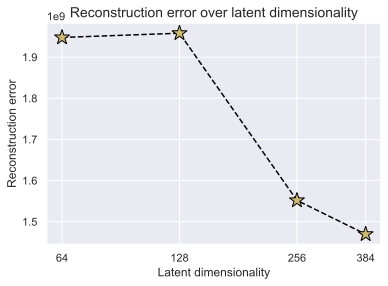

In [9]:
#@title Loss vs. Latent Dimensionality
latent_dims = sorted([k for k in model_dict])
val_scores = [model_dict[k]["result"]["val"][0]["test_loss"] for k in latent_dims]

fig = plt.figure(figsize=(6,4))
plt.plot(latent_dims, val_scores, '--', color="#000", marker="*", markeredgecolor="#000", markerfacecolor="y", markersize=16)
plt.xscale("log")
plt.xticks(latent_dims, labels=latent_dims)
plt.title("Reconstruction error over latent dimensionality", fontsize=14)
plt.xlabel("Latent dimensionality")
plt.ylabel("Reconstruction error")
plt.minorticks_off()
# plt.ylim(0,)
plt.show()

In [211]:
def visualize_reconstructions(model, input_imgs):
    # Reconstruct images
    model.eval()
    with torch.no_grad():
        reconst_imgs = model(input_imgs.to(model.device))
    reconst_imgs = reconst_imgs.cpu()

    for i in range(len(reconst_imgs)):
        print("True Spectrogram + Sound:")
        spectrogram_true = recompose_spect(input_imgs[i][0], input_imgs[i][1])
        show_spectro(times, freqs, spectrogram_true)
        spectro_to_audio(spectrogram_true, sample_rate)

        print()
        print("Reconstructed Spectrogram + Sound:")
        spectrogram_gen = recompose_spect(reconst_imgs[i][0], reconst_imgs[i][1])
        show_spectro(times, freqs, spectrogram_gen)
        spectro_to_audio(spectrogram_gen, sample_rate)
        print()
        print("===========================================")
        print("===========================================")
        print()
        print()

In [212]:
times = np.linspace(0, 1, 128)
freqs = np.linspace(0, 2032, 128)

In [213]:
input_imgs = test_dataset[0:4]

for latent_dim in model_dict:
    visualize_reconstructions(model_dict[latent_dim]["model"], input_imgs[0])

True Spectrogram + Sound:



Reconstructed Spectrogram + Sound:





True Spectrogram + Sound:



Reconstructed Spectrogram + Sound:





True Spectrogram + Sound:



Reconstructed Spectrogram + Sound:





True Spectrogram + Sound:



Reconstructed Spectrogram + Sound:


###Generate from Latent Space:

In [184]:
ls = torch.tensor(np.random.rand(48)*0.01).to(torch.double)
ls = ls.reshape([1, 48])
ls.shape

torch.Size([1, 48])

In [175]:
pred = model_dict[latent_dim]["model"].decoder(ls).detach().numpy()

spectrogram_gen = recompose_spect(pred[0][0], pred[0][1])
show_spectro(times, freqs, spectrogram_gen)
spectro_to_audio(spectrogram_gen, sample_rate)